Ms Sql connection

In [1]:
#importing libraries
from sqlalchemy import create_engine
import pandas as pd

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [2]:
#!pip install datashader

In [3]:
SERVER='DESKTOP-J8OCEUG\SQLEXPRESS'
DATABASE= 'Sales'
DRIVER= 'SQL server Native client 11.0'
USERNAME= 'mildred'
PASSWORD= 'Mildred*7'
DATABASE_CONNECTION= f'mssql://{USERNAME}:{PASSWORD}@{SERVER}/{DATABASE}?driver={DRIVER}'

In [4]:
engine = create_engine(DATABASE_CONNECTION)
connection=engine.connect()

In [5]:
pd.read_sql_query('select count (*) from salestb', connection)

,
0,500000


In [6]:
df=pd.read_sql_query('select * from salestb', engine)
df.head()

,region,country,item_type,sales_channel,order_priority,order_date,order_ID,ship_date,units_sold,unit_price,unit_cost,total_revenue,total_cost,total_profit
0,Sub-Saharan Africa,South Africa,Fruits,Offline,M,7/27/2012,443368995,7/28/2012,1593,9.33,6.92,14862.69,11023.56,3839.13
1,Middle East and North Africa,Morocco,Clothes,Online,M,9/14/2013,667593514,10/19/2013,4611,109.28,35.84,503890.08,165258.24,338631.84
2,Australia and Oceania,Papua New Guinea,Meat,Offline,M,5/15/2015,940995585,06/04/2015,360,421.89,364.69,151880.4,131288.4,20592
3,Sub-Saharan Africa,Djibouti,Clothes,Offline,H,5/17/2017,880811536,07/02/2017,562,109.28,35.84,61415.36,20142.08,41273.28
4,Europe,Slovakia,Beverages,Offline,L,10/26/2016,174590194,12/04/2016,3973,47.45,31.79,188518.85,126301.67,62217.18


In [7]:
df['region'].unique()

array(['Sub-Saharan Africa', 'Middle East and North Africa',
       'Australia and Oceania', 'Europe', 'Asia',
       'Central America and the Caribbean', 'North America'], dtype=object)

In [8]:
df.columns

Index(['region', 'country', 'item_type', 'sales_channel', 'order_priority',
       'order_date', 'order_ID', 'ship_date', 'units_sold', 'unit_price',
       'unit_cost', 'total_revenue', 'total_cost', 'total_profit'],
      dtype='object')

In [9]:
df.nunique()

region                 7
country              185
item_type             12
sales_channel          2
order_priority         4
order_date          2766
order_ID          500000
ship_date           2816
units_sold         10000
unit_price            12
unit_cost             12
total_revenue     118520
total_cost        118360
total_profit      118404
dtype: int64

In [10]:
df.item_type.unique()

array(['Fruits', 'Clothes', 'Meat', 'Beverages', 'Office Supplies',
       'Cosmetics', 'Snacks', 'Personal Care', 'Household', 'Vegetables',
       'Baby Food', 'Cereal'], dtype=object)

In [11]:
df.isnull().sum()
#no nulls

region            0
country           0
item_type         0
sales_channel     0
order_priority    0
order_date        0
order_ID          0
ship_date         0
units_sold        0
unit_price        0
unit_cost         0
total_revenue     0
total_cost        0
total_profit      0
dtype: int64

In [12]:
df.duplicated()
#no duplicates

0         False
1         False
2         False
3         False
4         False
          ...  
499995    False
499996    False
499997    False
499998    False
499999    False
Length: 500000, dtype: bool

## EDA

### 1. Univariate

In [13]:
df.item_type.value_counts()

Personal Care      41789
Cosmetics          41717
Snacks             41706
Clothes            41689
Fruits             41684
Meat               41673
Baby Food          41657
Vegetables         41655
Cereal             41619
Household          41617
Beverages          41616
Office Supplies    41578
Name: item_type, dtype: int64

In [14]:
df.sales_channel.value_counts()

Offline    250161
Online     249839
Name: sales_channel, dtype: int64

In [15]:
df.region.value_counts()

Sub-Saharan Africa                   130422
Europe                               129286
Asia                                  72958
Middle East and North Africa          62020
Central America and the Caribbean     53964
Australia and Oceania                 40508
North America                         10842
Name: region, dtype: int64

In [16]:
df.country.value_counts()

Cape Verde        2840
Liberia           2805
Guinea            2805
Singapore         2804
New Zealand       2797
                  ... 
Iran              2616
Turkey            2614
Luxembourg        2606
Germany           2605
United Kingdom    2601
Name: country, Length: 185, dtype: int64

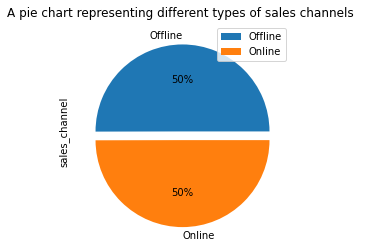

In [17]:

#pie chart of the region
explode = [0, 0.1]

#labels= Ins['region']

df.sales_channel.value_counts().plot(kind="pie", explode=explode, autopct='%1.0f%%')
plt.title('A pie chart representing different types of sales channels ')
plt.legend()
plt.show()

Text(0.5, 1.0, 'Frequency Distribuition- total_profit')

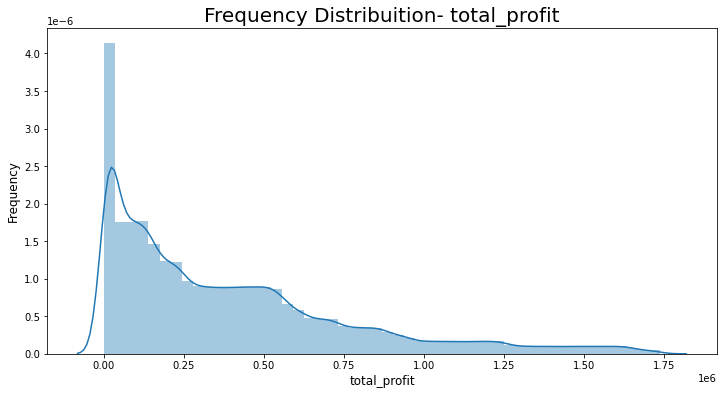

In [18]:
#profit
plt.figure(figsize=(12,6))
m = sns.distplot(df["total_profit"])
m.set_xlabel("total_profit", fontsize=12)
m.set_ylabel("Frequency", fontsize=12)
m.set_title("Frequency Distribuition- total_profit", fontsize=20)

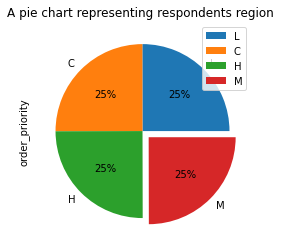

In [19]:

#pie chart of the region
explode = [0, 0, 0, 0.1]

#labels= Ins['region']

df.order_priority.value_counts().plot(kind="pie", explode=explode, autopct='%1.0f%%')
plt.title('A pie chart representing respondents region ')
plt.legend()
plt.show()

Text(0.5, 1.0, 'Frequency Distribuition- total_revenue')

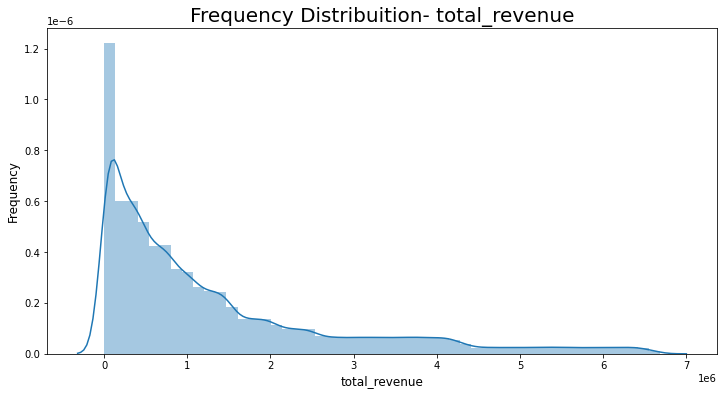

In [20]:
#revenue
plt.figure(figsize=(12,6))
m = sns.distplot(df["total_revenue"])
m.set_xlabel("total_revenue", fontsize=12)
m.set_ylabel("Frequency", fontsize=12)
m.set_title("Frequency Distribuition- total_revenue", fontsize=20)

<AxesSubplot:ylabel='item_type'>

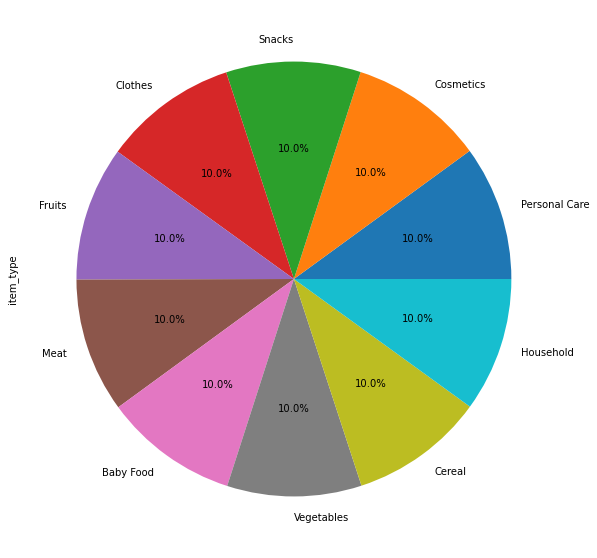

In [21]:
plt.figure(figsize=(12,10))
df['item_type'].value_counts().head(10).plot.pie(autopct="%1.1f%%")

<AxesSubplot:ylabel='region'>

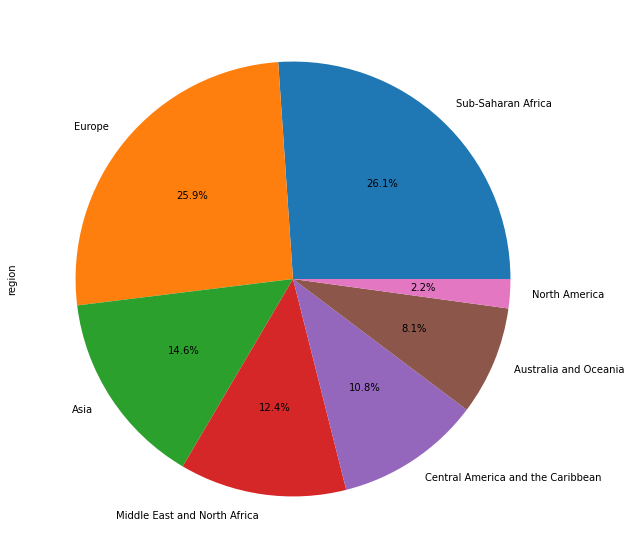

In [22]:
plt.figure(figsize=(12,10))
df['region'].value_counts().head(10).plot.pie(autopct="%1.1f%%")

### 2. Bivariate analysis

In [23]:
#converting datatypes
df["total_profit"]=df["total_profit"].astype(float)

In [24]:
df["total_cost"]=df["total_cost"].astype(float)

In [25]:
df = df.astype({'total_revenue': 'float', 'unit_cost': 'float', 'unit_price': 'float', 'units_sold': 'int'})

In [26]:
df["ship_date"]= pd.to_datetime(df["ship_date"])

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   region          500000 non-null  object        
 1   country         500000 non-null  object        
 2   item_type       500000 non-null  object        
 3   sales_channel   500000 non-null  object        
 4   order_priority  500000 non-null  object        
 5   order_date      500000 non-null  object        
 6   order_ID        500000 non-null  object        
 7   ship_date       500000 non-null  datetime64[ns]
 8   units_sold      500000 non-null  int32         
 9   unit_price      500000 non-null  float64       
 10  unit_cost       500000 non-null  float64       
 11  total_revenue   500000 non-null  float64       
 12  total_cost      500000 non-null  float64       
 13  total_profit    500000 non-null  float64       
dtypes: datetime64[ns](1), float64(5), in

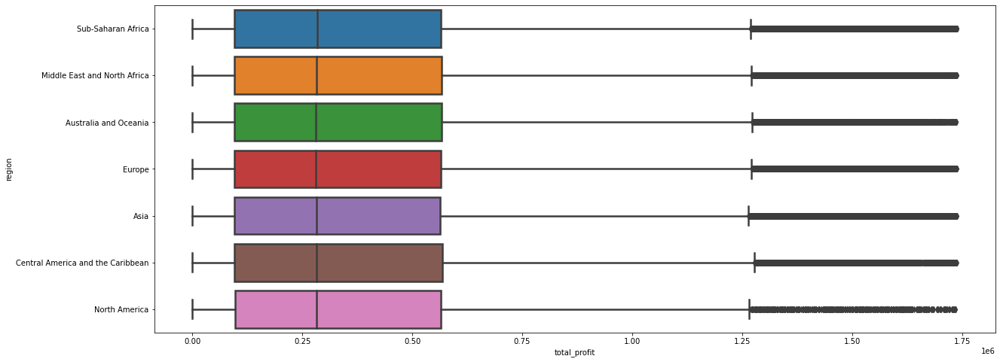

In [28]:
#box plot using seaborn
plt.figure(figsize = (20,8))
ax = sns.boxplot(x="total_profit" ,y="region", data=df, linewidth=2.5)
plt.show()

In [29]:
df.tail()

,region,country,item_type,sales_channel,order_priority,order_date,order_ID,ship_date,units_sold,unit_price,unit_cost,total_revenue,total_cost,total_profit
499995,Asia,Myanmar,Fruits,Offline,L,1/16/2015,134026181,2015-02-18,180,9.33,6.92,1679.40,1245.60,433.80
499996,Australia and Oceania,New Zealand,Office Supplies,Online,H,1/22/2011,987753570,2011-02-01,7086,651.21,524.96,4614474.06,3719866.56,894607.50
499997,Europe,Lithuania,Snacks,Online,C,1/25/2017,766976869,2017-01-26,4354,152.58,97.44,664333.32,424253.76,240079.56
499998,Asia,Malaysia,Beverages,Offline,H,3/13/2016,537369906,2016-03-18,8552,47.45,31.79,405792.40,271868.08,133924.32
499999,Europe,Slovakia,Household,Online,H,5/13/2015,984919011,2015-06-12,8277,668.27,502.54,5531270.79,4159523.58,1371747.21


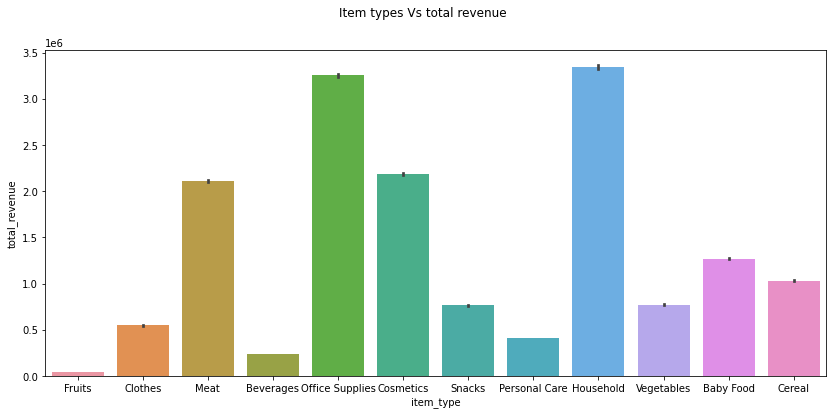

In [30]:
fig=plt.figure(figsize=(14, 6))
fig.suptitle('Item types Vs total revenue')
sns.barplot(x=df['item_type'], y=df['total_revenue'])
plt.show();

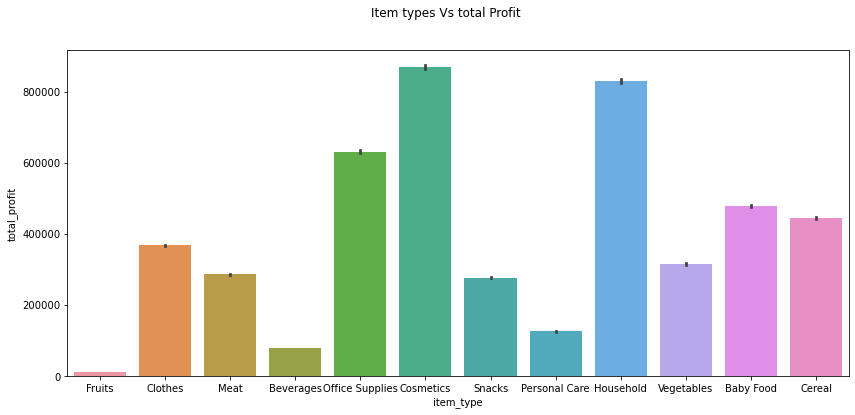

In [31]:
fig=plt.figure(figsize=(14, 6))
fig.suptitle('Item types Vs total Profit')
sns.barplot(x=df['item_type'], y=df['total_profit'])
plt.show();

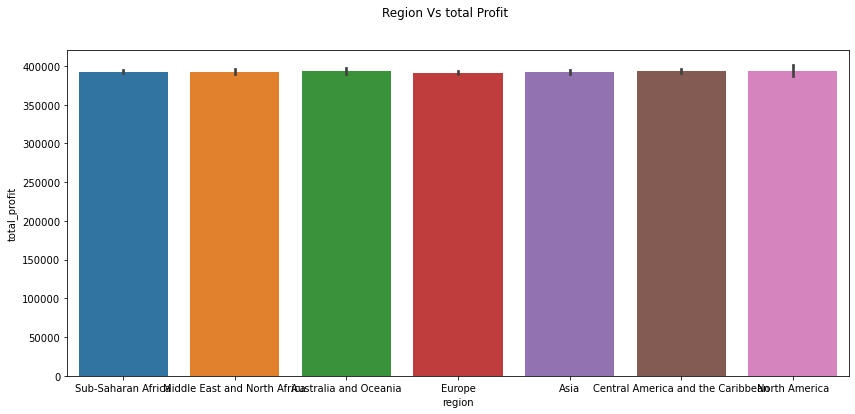

In [32]:
fig=plt.figure(figsize=(14, 6))
fig.suptitle('Region Vs total Profit')
sns.barplot(x=df['region'], y=df['total_profit'])
plt.show();

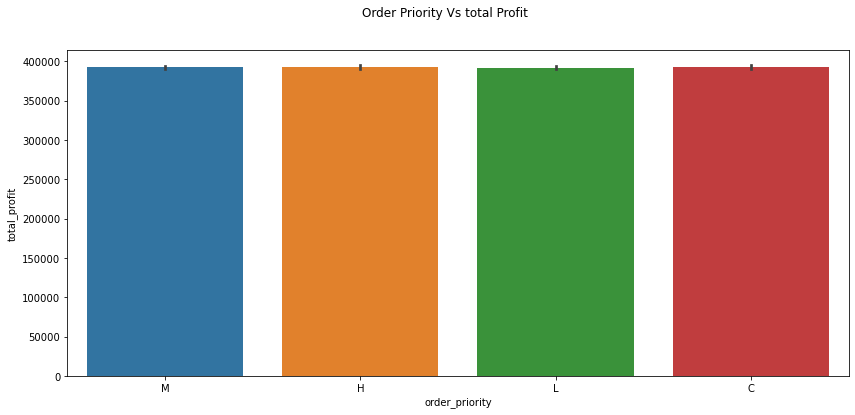

In [33]:
fig=plt.figure(figsize=(14, 6))
fig.suptitle('Order Priority Vs total Profit')
sns.barplot(x=df['order_priority'], y=df['total_profit'])
plt.show();

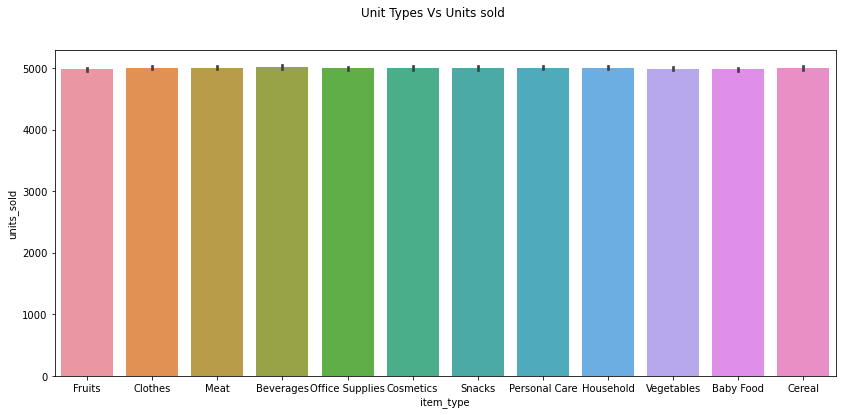

In [34]:
fig=plt.figure(figsize=(14, 6))
fig.suptitle('Unit Types Vs Units sold')
sns.barplot(x=df['item_type'], y=df['units_sold'])
plt.show();

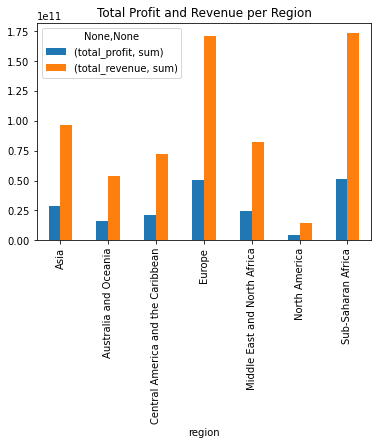

In [35]:

df.groupby('region')['total_profit','total_revenue'].agg(['sum']).plot.bar()
plt.title('Total Profit and Revenue per Region')
# plt.legend('Profit')
# plt.legend('Sales')
plt.show()

## Dashboard

In [36]:
#importing necessary libraries
import panel as pn
pn.extension('tabulator')

import hvplot.pandas

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
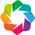

In [37]:
import hvplot.pandas
import holoviews as hv

hv.extension('bokeh')

In [38]:
def environment():
    try:
        get_ipython()
        return "notebook"
    except:
        return "server"
environment()

'notebook'

In [39]:
#defining color palette
PALETTE = ["#ff6f69", "#ffcc5c", "#88d8b0", ]
pn.Row(
    pn.layout.HSpacer(height=50, background=PALETTE[0]),
    pn.layout.HSpacer(height=50, background=PALETTE[1]),
    pn.layout.HSpacer(height=50, background=PALETTE[2]),
)

Row
    [0] HSpacer(background='#ff6f69', height=50)
    [1] HSpacer(background='#ffcc5c', height=50)
    [2] HSpacer(background='#88d8b0', height=50)

In [40]:
import pandas as pd
import numpy as np


### Make DataFrame Pipeline Interactive

In [41]:
#creating a year column; extracting it from order date column
import datetime
year = datetime.datetime.today().year

In [42]:
df['year'] = pd.DatetimeIndex(df['order_date']).year

In [43]:
df.head()

,region,country,item_type,sales_channel,order_priority,order_date,order_ID,ship_date,units_sold,unit_price,unit_cost,total_revenue,total_cost,total_profit,year
0,Sub-Saharan Africa,South Africa,Fruits,Offline,M,7/27/2012,443368995,2012-07-28,1593,9.33,6.92,14862.69,11023.56,3839.13,2012
1,Middle East and North Africa,Morocco,Clothes,Online,M,9/14/2013,667593514,2013-10-19,4611,109.28,35.84,503890.08,165258.24,338631.84,2013
2,Australia and Oceania,Papua New Guinea,Meat,Offline,M,5/15/2015,940995585,2015-06-04,360,421.89,364.69,151880.40,131288.40,20592.00,2015
3,Sub-Saharan Africa,Djibouti,Clothes,Offline,H,5/17/2017,880811536,2017-07-02,562,109.28,35.84,61415.36,20142.08,41273.28,2017
4,Europe,Slovakia,Beverages,Offline,L,10/26/2016,174590194,2016-12-04,3973,47.45,31.79,188518.85,126301.67,62217.18,2016


In [44]:
#removing the order_date column
sales = df.drop('order_date', 1)
sales.columns

Index(['region', 'country', 'item_type', 'sales_channel', 'order_priority',
       'order_ID', 'ship_date', 'units_sold', 'unit_price', 'unit_cost',
       'total_revenue', 'total_cost', 'total_profit', 'year'],
      dtype='object')

In [45]:
sales.head(2)

,region,country,item_type,sales_channel,order_priority,order_ID,ship_date,units_sold,unit_price,unit_cost,total_revenue,total_cost,total_profit,year
0,Sub-Saharan Africa,South Africa,Fruits,Offline,M,443368995,2012-07-28,1593,9.33,6.92,14862.69,11023.56,3839.13,2012
1,Middle East and North Africa,Morocco,Clothes,Online,M,667593514,2013-10-19,4611,109.28,35.84,503890.08,165258.24,338631.84,2013


In [46]:
idf = sales.interactive()
idf.head(3)

In [47]:
#define panel widgets
year_slider = pn.widgets.IntSlider(name='Year slider', start=2010, end=2017, value=2010)
year_slider

IntSlider(end=2017, name='Year slider', start=2010, value=2010)

In [48]:
#region widget
ch_region = pn.widgets.CheckBoxGroup(
    name='Checkbox Group', value=['Sub-Saharan Africa', 'Asia'], options=['Sub-Saharan Africa', 'Middle Eastand North Africa',
                                                               'Australia and Oceania', 'Europe', 'Asia',
                                                              'Central America and the Caribbean', 'North America'],
    inline=True)

ch_region

CheckBoxGroup(inline=True, name='Checkbox Group', options=['Sub-Saharan Africa', ...], value=['Sub-Saharan Africa', ...])

Combine pipeline and widgets

In [49]:
ipipeline = (
    idf
    .groupby(['region','item_type', 'sales_channel', 'order_priority','total_profit','unit_price',
              'unit_cost','total_revenue', 'total_cost','year'])['units_sold'].mean()
    .to_frame()
    .reset_index()
    .sort_values(by='region')  
    .reset_index(drop=True)
)
ipipeline.head()

### Pipe to table

In [50]:
if environment()=="server":
   theme="fast"
else:
   theme="simple"

In [51]:
#creating interactive table
itable = ipipeline.pipe(pn.widgets.Tabulator, pagination='remote', page_size=10, theme=theme)
itable

In [52]:
line_plot=ipipeline.hvplot(x='year', y='total_revenue')
line_plot

In [53]:
#order_plot = ipipeline.hvplot(kind='bar', x='order_priority', y=['total_profit','total_revenue'], stacked=True, legend=True)
#order_plot

In [54]:
#removing the order_date column
sales = df.drop('order_date', 1)
sales.columns

Index(['region', 'country', 'item_type', 'sales_channel', 'order_priority',
       'order_ID', 'ship_date', 'units_sold', 'unit_price', 'unit_cost',
       'total_revenue', 'total_cost', 'total_profit', 'year'],
      dtype='object')

In [55]:
idf = sales.interactive()
idf.head(3)

In [56]:
#define panel widgets
year_slider = pn.widgets.IntSlider(name='Year slider', start=2010, end=2017, value=2010)
year_slider

IntSlider(end=2017, name='Year slider', start=2010, value=2010)

In [57]:
#region widget
ch_region = pn.widgets.CheckBoxGroup(
    name='Checkbox Group', value=['Sub-Saharan Africa', 'Asia'], options=['Sub-Saharan Africa', 'Middle Eastand North Africa',
                                                               'Australia and Oceania', 'Europe', 'Asia',
                                                              'Central America and the Caribbean', 'North America'],
    inline=True)

ch_region

CheckBoxGroup(inline=True, name='Checkbox Group', options=['Sub-Saharan Africa', ...], value=['Sub-Saharan Africa', ...])

Combine pipeline and widgets

In [58]:
ipipeline = (
    idf[
        (idf.year == year_slider) 
        
    ]
    .groupby(['region','item_type', 'sales_channel', 'order_priority','total_profit','unit_price',
              'unit_cost','total_revenue', 'total_cost','year'])['units_sold'].mean()
    .to_frame()
    .reset_index()
    .sort_values(by='region')  
    .reset_index(drop=True)
)
ipipeline.head()

### Pipe to table

In [59]:
if environment()=="server":
   theme="fast"
else:
   theme="simple"

In [60]:
#creating interactive table
itable = ipipeline.pipe(pn.widgets.Tabulator, pagination='remote', page_size=10, theme=theme)
itable

### 1. Total profit per Item

In [61]:
p_groups = ipipeline.groupby(['item_type'])['total_profit'].sum()
p_groups

In [62]:
#bar graph of accumulated profit per item
profit_plot = p_groups.hvplot(kind='bar')
profit_plot

### 2. Accumulated revenue per Item

In [63]:
r_groups = ipipeline.groupby(['item_type'])['total_revenue'].sum()
r_groups

In [64]:
#bar graph of accumulated revenue per item
r_plot = r_groups.hvplot(kind='bar')
r_plot

### 3. Total revenue by channel

### 4. Total Revenue trend

In [65]:
revenue_pipeline = (
    idf
    .groupby(['region','item_type', 'sales_channel', 'order_priority','total_profit','unit_price',
              'unit_cost','total_revenue', 'total_cost','year'])['units_sold'].mean()
    .to_frame()
    .reset_index()
    .sort_values(by='region')  
    .reset_index(drop=True)
)

In [66]:
revenue_pipeline

In [67]:
rev_groups = revenue_pipeline.groupby(['item_type','year'])['total_revenue'].sum()
rev_groups

In [68]:
df.item_type.unique()

array(['Fruits', 'Clothes', 'Meat', 'Beverages', 'Office Supplies',
       'Cosmetics', 'Snacks', 'Personal Care', 'Household', 'Vegetables',
       'Baby Food', 'Cereal'], dtype=object)

In [69]:
#bar graph of accumulated revenue per item
rev_plot = rev_groups.hvplot(kind='bar', legend='top_right', width=1000, height=400)
rev_plot

### 5. Total Revenue & profit

In [70]:
rp_groups = ipipeline.groupby(['item_type'])['total_revenue', 'total_profit'].sum()
rp_groups

In [71]:
#bar graph of accumulated revenue & profit per item over time
rp_plot = rp_groups.hvplot(kind='line')
rp_plot

In [72]:
#Total Revenue
T_Revenue = ipipeline['total_revenue'].sum()
T_Revenue

In [73]:
#Total Profit
T_profit = ipipeline['total_profit'].sum()
T_profit

In [74]:
#Total cost
T_cost = ipipeline['unit_cost'].sum()
T_cost

In [75]:
#Total units sold
T_unit = ipipeline['units_sold'].sum()
T_unit

In [76]:
reg=ipipeline.hvplot(kind='violin', y='total_revenue', by='item_type', height=500)
reg

###  Layout using Template

In [77]:
#Layout using Template
template = pn.template.FastListTemplate(
    title='Intercative Sales Dashboard', 
     main=[pn.Row(year_slider),
           pn.Row(pn.Column('## Total Revenues',T_Revenue.panel(width=300), margin=(0,25)), 
                  pn.Column('## Total Profits',T_profit.panel(width=300)),
                  pn.Column('## Total Costs',T_cost.panel(width=300)),
                  pn.Column('## Total Units',T_unit.panel(width=300))),
           pn.Row(pn.Column(rp_plot.panel(width=630), margin=(0,25)), 
                  pn.Column(r_plot.panel(width=530))),
           pn.Row(pn.Column(rev_plot.panel(width=700)))],
           
    accent_base_color="#88d8b0",
    header_background="#88d8b0",
    
) 

template.show()
#template.servable();

Launching server at http://localhost:60644
